In [49]:
import pandas as pd
df = pd.read_csv('cat_acidentes.csv', sep=';')

In [50]:
df.head()

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2025-07-01 01:32:30,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2025-07-01 01:32:30,598.0,0.0,2020-01-01 00:00:00,1,0,0,0,0,0,...,NaN,NaN,AV BENTO GONCALVES,NaN,ABALROAMENTO,QUARTA-FEIRA,03:00:00.0000000,NOITE,LESTE,NaN
2,2025-07-01 01:32:30,1271.0,0.0,2020-01-01 00:00:00,1,1,0,0,0,1,...,NaN,NaN,AV INDEPENDENCIA,NaN,ATROPELAMENTO,QUARTA-FEIRA,23:00:00.0000000,NOITE,LESTE,NaN
3,2025-07-01 01:32:30,1901.0,0.0,2020-01-02 00:00:00,2,0,0,0,0,0,...,NaN,NaN,AV EDUARDO PRADO,NaN,ATROPELAMENTO,QUINTA-FEIRA,00:05:00.0000000,NOITE,SUL,NaN
4,2025-07-01 01:32:30,3302.0,0.0,2020-01-02 00:00:00,1,0,0,0,0,1,...,-51.211535,-30.081535,AV TERESOPOLIS,NaN,ABALROAMENTO,QUINTA-FEIRA,09:00:00.0000000,DIA,SUL,NaN


In [51]:
import folium
from folium.plugins import HeatMap

map = folium.Map(location=[-30.1, -51.15], zoom_start=11)
map

In [52]:
df.dropna(subset=['latitude', 'longitude'], inplace=True)

In [53]:
coordinates = list(zip(df.latitude, df.longitude))
heat_map = HeatMap(coordinates, radius=10, blur=10)
map.add_child(heat_map)

map

In [54]:
from folium.plugins import MarkerCluster

map = folium.Map(location=[-30.1, -51.15], zoom_start=11)
map_cluster = MarkerCluster(coordinates)
map.add_child(map_cluster)

map

In [55]:
df.data

0        2020-10-17 00:00:00
4        2020-01-02 00:00:00
6        2020-01-02 00:00:00
8        2020-01-02 00:00:00
11       2020-01-02 00:00:00
                ...         
71405    2025-04-14 00:00:00
71406    2025-04-14 00:00:00
71407    2025-04-14 00:00:00
71408    2025-04-14 00:00:00
71409    2025-06-23 00:00:00
Name: data, Length: 61015, dtype: object

In [56]:
df['data'] = pd.to_datetime(df['data'])
df_year = df['data'].dt.year.value_counts()
df_year

data
2023    14573
2024    13702
2022    13328
2021    11701
2025     4810
2020     2896
2027        2
2026        2
2202        1
Name: count, dtype: int64

In [57]:
df_year= df[(df['data'].dt.year >= 2000) & (df['data'].dt.year <= 2025)]
df_year = df_year['data'].dt.year.value_counts()
df_year

data
2023    14573
2024    13702
2022    13328
2021    11701
2025     4810
2020     2896
Name: count, dtype: int64

In [58]:
import matplotlib.pyplot as plt


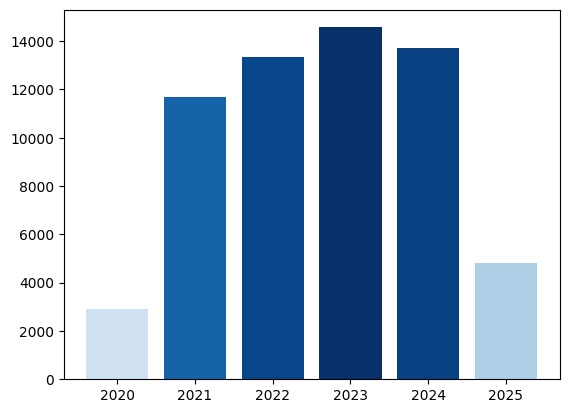

In [59]:
gradiente = df_year/df_year.max()
collor = plt.cm.Blues(gradiente)

plt.bar(df_year.index, df_year.values, color=collor)
plt.show()